In [1]:
import cv2
import sys
import glob
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.ndimage import center_of_mass
from PIL import Image, ImageDraw
import math
import numpy.matlib as npm
from matplotlib.patches import Polygon
import os
import scipy as sp
from scipy import spatial as sps
import scipy.ndimage
from bbox.min_bounding_rect import minBoundingRect
import PIL
import os
import pickle as pk
from matplotlib.colors import Normalize
from mpl_toolkits.axes_grid1 import make_axes_locatable

#Count non black pixels in PIL images
def count_nonblack_pil(img):
    """Return the number of pixels in img that are not black.
    img must be a PIL.Image object in mode RGB.

    """
    bbox = img.getbbox()
    if not bbox: return 0
    return sum(img.crop(bbox)
               .point(lambda x: 255 if x else 0)
               .convert("L")
               .point(bool)
               .getdata())

#Plot tile distribution of datasets (train/val/test) on orthophoto

path_pkl_train = '/home/martin/container/autofs/data/hail/detectron2/products/hparam_tuning/run-3/hail_20210620_r1/train/pkl/'
path_pkl_val = '/home/martin/container/autofs/data/hail/detectron2/products/hparam_tuning/run-3/hail_20210620_r1/val/pkl/'
path_pkl_test = '/home/martin/container/autofs/data/hail/detectron2/products/hparam_tuning/run-3/hail_20210620_r1/test/pkl/'

#orthophoto_file = '/home/martin/container/autofs/data/hail/hail_20210620_r1/odm_orthophoto/odm_orthophoto_croped.png'
orthophoto_file = '/home/martin/container/autofs/data/hail/odm/hail_20210620_r1/odm_orthophoto/odm_20210620_r1.png'

In [2]:
files_train = glob.glob(path_pkl_train+'*.pkl')
files_train.sort()

files_val = glob.glob(path_pkl_val+'*.pkl')
files_val.sort()

files_test = glob.glob(path_pkl_test+'*.pkl')
files_test.sort()

x0 = 0
y0 = 0

x_glob = []
y_glob = []

for file in files_train:
    filename = Path(file).stem
    #tile_name = filename[11:32]+'.png'

    #get tile row and column value
    t_row = np.array(int(filename[27:29]))
    t_col = np.array(int(filename[30:32]))
    
    #x/y coordinates in global picture
    x_glob_tmp = x0 + (t_col*500)
    y_glob_tmp = y0 + (t_row*500)
    
    x_glob.append(x_glob_tmp)
    y_glob.append(y_glob_tmp)
    
tile_coords_train = np.vstack((x_glob,y_glob))

x_glob = []
y_glob = []

for file in files_val:
    filename = Path(file).stem
    #tile_name = filename[11:32]+'.png'

    #get tile row and column value
    t_row = np.array(int(filename[27:29]))
    t_col = np.array(int(filename[30:32]))
    
    #x/y coordinates in global picture
    x_glob_tmp = x0 + (t_col*500)
    y_glob_tmp = y0 + (t_row*500)
    
    x_glob.append(x_glob_tmp)
    y_glob.append(y_glob_tmp)
    
tile_coords_val = np.vstack((x_glob,y_glob))

x_glob = []
y_glob = []

for file in files_test:
    filename = Path(file).stem
    #tile_name = filename[11:32]+'.png'

    #get tile row and column value
    t_row = np.array(int(filename[27:29]))
    t_col = np.array(int(filename[30:32]))
    
    #x/y coordinates in global picture
    x_glob_tmp = x0 + (t_col*500)
    y_glob_tmp = y0 + (t_row*500)
    
    x_glob.append(x_glob_tmp)
    y_glob.append(y_glob_tmp)
    
tile_coords_test = np.vstack((x_glob,y_glob))

#image_height = 22000
#image_width = 24500
#number_of_color_channels = 3
#color = (255,0,255)
#pixel_array = np.full((image_height, image_width, number_of_color_channels), color, dtype=np.uint8)

empty_mask = np.zeros([22000, 24500], dtype=int)
for i,x in enumerate(tile_coords_train[0]):
    y = tile_coords_train[1][i]
    empty_mask[y:y+500, x:x+500] = 1
    mask_train = empty_mask

empty_mask = np.zeros([22000, 24500], dtype=int)
for i,x in enumerate(tile_coords_val[0]):
    y = tile_coords_val[1][i]
    empty_mask[y:y+500, x:x+500] = 1
    mask_val = empty_mask

empty_mask = np.zeros([22000, 24500], dtype=int)
for i,x in enumerate(tile_coords_test[0]):
    y = tile_coords_test[1][i]
    empty_mask[y:y+500, x:x+500] = 1
    mask_test = empty_mask

In [3]:
#Get number of real pixels from the reconstruction
PIL.Image.MAX_IMAGE_PIXELS = 8046500000
count_nonblack_pil(Image.open(orthophoto_file))

500268873

In [3]:
PIL.Image.MAX_IMAGE_PIXELS = 8046500000
image = np.asarray(Image.open(orthophoto_file))
img_hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
#img_train_masked = np.ma.masked_array(img_hls[:,:,1], mask=mask_train)

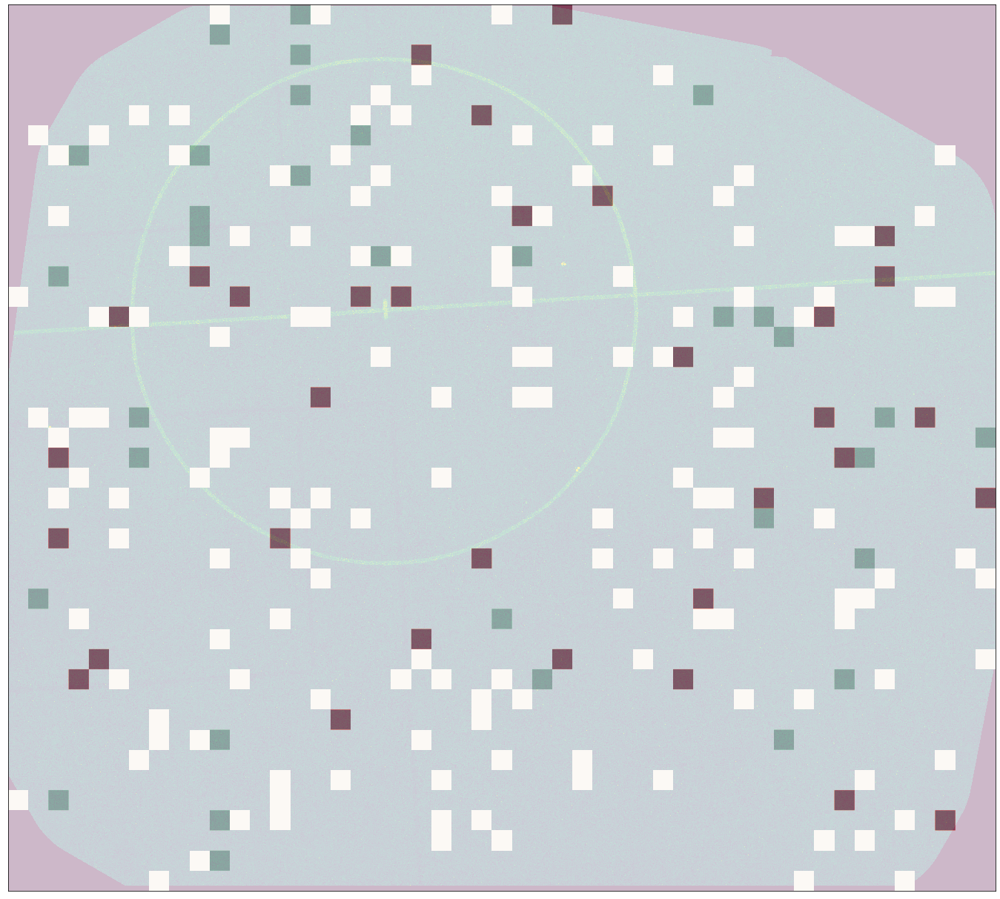

In [8]:
fig, ax = plt.subplots(figsize=[24.5, 22])
plt.imshow(img_train_masked, cmap='viridis', interpolation='none', norm=None, vmin=0, vmax=255)
plt.imshow(mask_val,cmap='Greens',alpha = 0.5)
plt.imshow(mask_test,cmap='Reds',alpha = 0.5)
#plt.axes('off')
plt.xticks([])
plt.yticks([])
plt.savefig('ML_tile_distribution_new.png',dpi=300,bbox_inches='tight',facecolor='white')

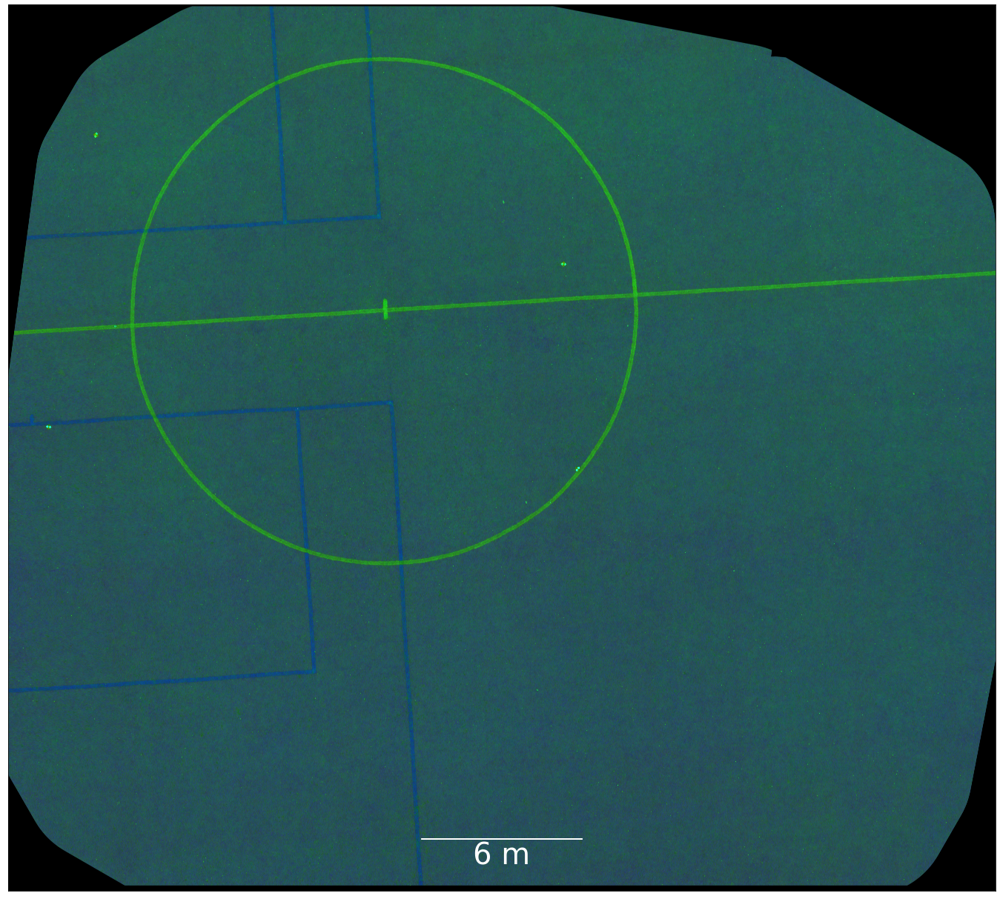

In [14]:
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
fontprops = fm.FontProperties(size=40)

import matplotlib.patches as patches
fig, ax = plt.subplots(figsize=[24.5, 22])
ax.imshow(img_hls)

xmin = 2400
xmax = 19393
ymin = 3700
ymax = 19393

# Create a Rectangle patch
#rect = patches.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, linewidth=3, edgecolor='r', facecolor='none')

# Add the patch to the Axes
#ax.add_patch(rect)

#plt.imshow(mask_val,cmap='Greens',alpha = 0.5)
#plt.imshow(mask_test,cmap='Reds',alpha = 0.5)
#plt.axes('off')

scalebar = AnchoredSizeBar(ax.transData,
                           4000, '6 m', 'lower center', 
                           pad=0.6,
                           color='white',
                           frameon=False,
                           size_vertical=30,
                           fontproperties=fontprops)

ax.add_artist(scalebar)

plt.xticks([])
plt.yticks([])
plt.savefig('HLS_orthophoto_test.png',dpi=300,bbox_inches='tight',facecolor='white')

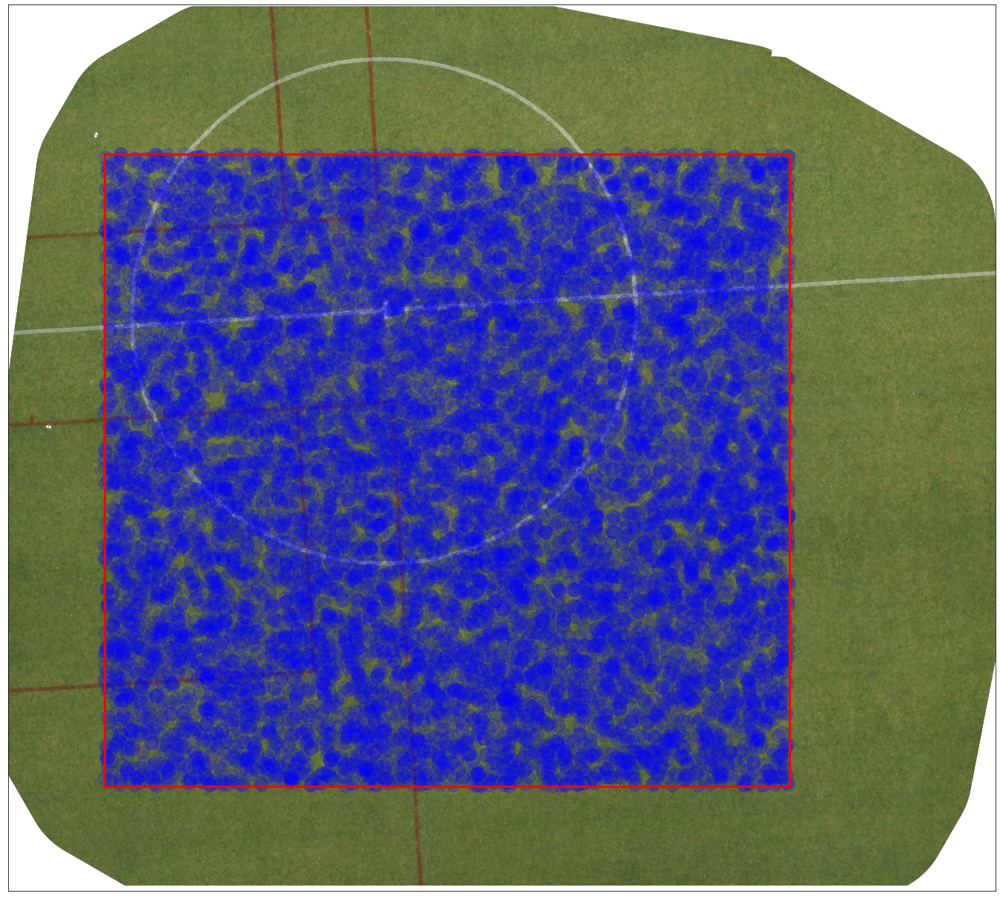

In [6]:
import matplotlib.patches as patches
from matplotlib.patches import Circle

fig, ax = plt.subplots(figsize=[24.5, 22])
ax.set_aspect('equal')

ax.imshow(image)

xmin = 2400
xmax = 19393
ymin = 3700
ymax = 19393

#Load the V-Sensor dictionary:
with open('vsensor_R10000_600m2.pkl','rb') as f:
    vsensor_dict = pk.load(f)

# Now, loop through coord arrays, and create a circle at each x,y pair
for xx,yy in vsensor_dict['vsens_co']:
    circ = Circle((xx,yy),166.5,color='blue',alpha=0.2)
    ax.add_patch(circ)

# Create a Rectangle patch
rect = patches.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, linewidth=3, edgecolor='r', facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)
    
plt.xticks([])
plt.yticks([])
plt.savefig('RGB_orthophoto_sensor_v2.png',dpi=300,bbox_inches='tight',facecolor='white')

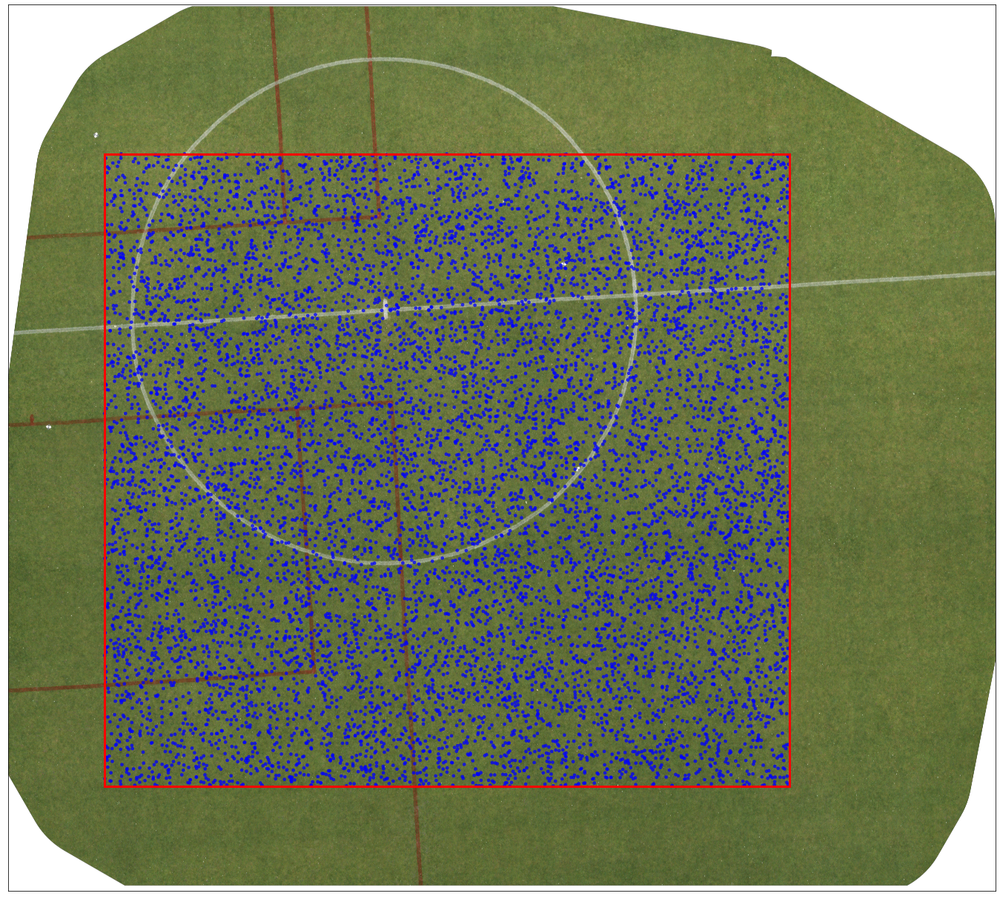

In [5]:
import matplotlib.patches as patches
from matplotlib.patches import Circle

fig, ax = plt.subplots(figsize=[24.5, 22])
ax.set_aspect('equal')

ax.imshow(image)

xmin = 2400
xmax = 19393
ymin = 3700
ymax = 19393

#Load the V-Sensor dictionary:
with open('vsensor_R10000_600m2.pkl','rb') as f:
    vsensor_dict = pk.load(f)

# Now, loop through coord arrays, and create a circle at each x,y pair
for xx,yy in vsensor_dict['vsens_co']:
    circ = Circle((xx,yy),33.33,color='blue',alpha=0.7)
    ax.add_patch(circ)

# Create a Rectangle patch
rect = patches.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, linewidth=3, edgecolor='r', facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)
    
plt.xticks([])
plt.yticks([])
plt.savefig('RGB_orthophoto_sensor_v2_REVISED.png',dpi=300,bbox_inches='tight',facecolor='white')

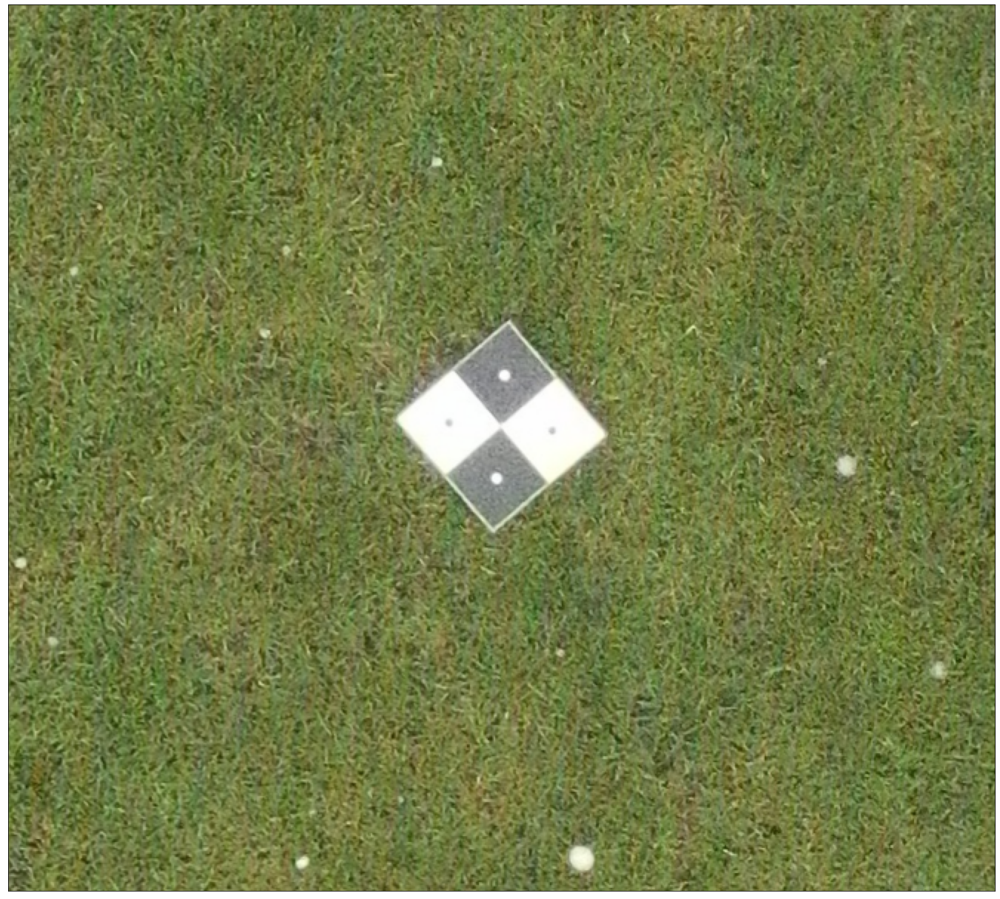

In [6]:
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
fontprops = fm.FontProperties(size=40)

Image2 = cv2.imread('zoom_ref.png')
Image2 = np.flip(Image2, axis=-1) 

import matplotlib.patches as patches
fig, ax = plt.subplots(figsize=[24.5, 22])
ax.imshow(Image2)

plt.xticks([])
plt.yticks([])
plt.savefig('zoom_test.png',dpi=300,bbox_inches='tight',facecolor='white')

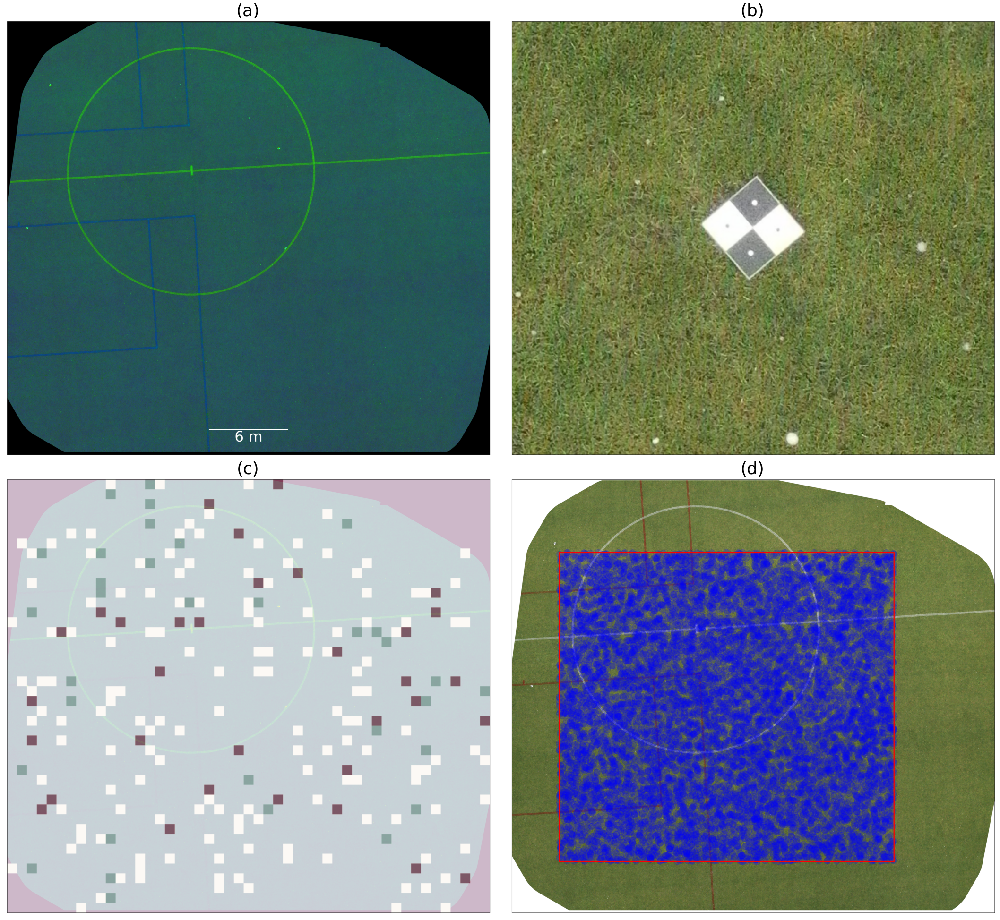

In [9]:
# create figure
fig = plt.figure(figsize=(30, 27))
  
# setting values to rows and column variables
rows = 2
columns = 2
  
# reading images
Image1 = cv2.imread('HLS_orthophoto_test.png')
Image3 = cv2.imread('ML_tile_distribution_new.png')
Image4 = cv2.imread('RGB_orthophoto_sensor_v2.png')
Image2 = cv2.imread('zoom_test.png')

# convert bgr to rgb for plotting with matplotlib
Image1 = np.flip(Image1, axis=-1) 
Image2 = np.flip(Image2, axis=-1) 
Image3 = np.flip(Image3, axis=-1)
Image4 = np.flip(Image4, axis=-1) 

# Adds a subplot at the 1st position
fig.add_subplot(rows, columns, 1)
  
# showing image
plt.imshow(Image1)
plt.axis('off')
plt.title("(a)", fontsize=36)

# Adds a subplot at the 2nd position
fig.add_subplot(rows, columns, 2)
  
# showing image
plt.imshow(Image2)
plt.axis('off')
plt.title("(b)", fontsize=36)
  
# Adds a subplot at the 3rd position
fig.add_subplot(rows, columns, 3)
  
# showing image
plt.imshow(Image3)
plt.axis('off')
plt.title("(c)", fontsize=36)

# Adds a subplot at the 4th position
fig.add_subplot(rows, columns, 4)
  
# showing image
plt.imshow(Image4)
plt.axis('off')
plt.title("(d)", fontsize=36)


fig.tight_layout(pad=0.5)

plt.savefig('figure_3.png',dpi=250,bbox_inches='tight',facecolor='white')